In [1]:
%reset
import xarray as xr
import glob
import numpy as np
import netCDF4 as nc
import warnings
import matplotlib.path as mpath
import cartopy.feature as cfeature

warnings.filterwarnings('ignore')
from matplotlib import pyplot as plt
from cmocean import cm
import warnings
warnings.filterwarnings('ignore')
import cartopy.crs as ccrs
import sys
sys.path.append('/gpfs/home/mep22dku/scratch/SOZONE/MO_pipeline/')
sys.path.append('/gpfs/home/mep22dku/scratch/SOZONE/UTILS/')
import scendict as sc
import utils as ut

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [2]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')


In [3]:
plt.rcParams.update({'font.size': 12})
font = {'family' : 'normal',
'weight' : 'bold',
'size'   : 12}


In [4]:
def plot_southern(fig, ax1, lons, lats, tdat, tvmin, 
                  tvmax, tticks, northex = -50, fs = 12, 
                  tit = '', cbarlab = '', tcmap = 'viridis', lm = True, cbr = True):
   
    ax1.set_extent([-180, 180, -80, -25], ccrs.PlateCarree())
    #make that circle
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax1.set_boundary(circle, transform=ax1.transAxes)
    lons = nav_lon[0:50,:]; lats = nav_lat[0:50,:]; 
    mesh = ax1.pcolormesh(lons, lats, tdat, cmap = tcmap, vmin = tvmin, vmax = tvmax, 
                     transform=ccrs.PlateCarree())
    
    ax1.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '110m', 
                                                 edgecolor='face', facecolor='k'))
    ax1.set_title(tit, fontsize = fs)
    cb = 0
    if cbr:
        cb = fig.colorbar(mesh, ax = ax1, orientation = 'horizontal',
                     pad = 0.06, fraction = 0.045, shrink = 0.9)
        cb.set_label(label=cbarlab,fontsize = 10)
        cb.set_ticks(tticks, fontsize = 105)
        cb.ax.tick_params(labelsize=10)
    return cb

In [5]:
def get_var_summer(year,runname,var):
    tdir = '/gpfs/home/mep22dku/scratch/SOZONE/MO_RESULTS/EXTRACT/ncs/'
    if var == 'wspd':
        w = xr.open_dataset(f'{tdir}/scen_{runname}_{var}_1948_2100.nc')
    elif var == 'votemper':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L0_1948_2100.nc')
    else:
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_1948_2100.nc')
    tdat = w[var].sel(time_counter=(w.time_counter.dt.month.isin([1, 2, 12])&
                                      w.time_counter.dt.year.isin([year])))
    ts = tdat.values
    tsum = (ts[0,:,:]*31+ts[1,:,:]*28+ts[1,:,:]*31)/90
    return(tsum)

def get_var_winter(year,runname,var):
    tdir = '/gpfs/home/mep22dku/scratch/SOZONE/MO_RESULTS/EXTRACT/ncs/'
    if var == 'wspd':
        w = xr.open_dataset(f'{tdir}/scen_{runname}_{var}_1948_2100.nc')
    elif var == 'votemper':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L0_1948_2100.nc')
    else:
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_1948_2100.nc')
    tdat = w[var].sel(time_counter=(w.time_counter.dt.month.isin([6, 7, 8])&
                                      w.time_counter.dt.year.isin([year])))
    ts = tdat.values
    tsum = (ts[0,:,:]*30+ts[1,:,:]*31+ts[1,:,:]*31)/92
    return(tsum)


tsum = get_var_summer(1948,'1ASA','Cflx')
tsum = get_var_summer(1948,'1A','wspd')

#### get coordinates

In [6]:
basin = nc.Dataset('/gpfs/data/greenocean/software/resources/ModelResources/BasinMasks/clq_basin_masks_ORCA.nc')
nav_lat = basin['Y'][:]
nav_lon = basin['X'][:]
lons = nav_lon[0:50,:]
lats = nav_lat[0:50,:]

In [7]:

run = False
if run:

    savin = False
    for tyr in range(1948,2101):
        fact = 0.42
        tfig = plt.figure(figsize=[31*fact, 44*fact])
        runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']

        for i in range(1,7):
            tits = ['2A \n (C-LOW, O3-1950) \n Cflx',
                    '1A \n(C-LOW, O3-HIST) \n Cflx',
                    '3A \n(C-LOW, O3-1990) \n Cflx',
                    '2B \n(C-HIGH, O3-1950) \n Cflx',
                    '1B \n(C-HIGH, O3-HIST) \n Cflx',
                    '3B \n(C-HIGH, O3-1990) \n Cflx']
            var = 'Cflx'; tmi = -3e-7; tma = 3e-7; tti = [-3e-7,0,3e-7]
            cl = 'mmol/m2/s'
            ax1 = tfig.add_subplot(6, 6, i, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = tits[i-1], cbarlab = cl, tcmap = cm.balance_r, lm = True, cbr = True)
        for i in range(1,7):
            var = 'dpCO2'; tmi = -100; tma = 100; tti = [-100,0,100]
            cl = 'uatm'
            ax1 = tfig.add_subplot(6, 6, i+6, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'dPCO2', cbarlab = cl, tcmap = cm.balance, lm = True, cbr = True)

        runs = ['2A', '1A','3A', '2B', '1B', '3B']
        for i in range(1,7):
            var = 'wspd'; tmi = 5; tma = 15; tti = [5,10,15]
            cl = 'm/s'
            ax1 = tfig.add_subplot(6, 6, i+12, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'wind speed', cbarlab = cl, tcmap = cm.matter, lm = True, cbr = True)

        runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']
        for i in range(1,7):
            var = 'mldkz5'; tmi = 0; tma = 100; tti = [0,50,100]
            cl = 'm'
            ax1 = tfig.add_subplot(6, 6, i+18, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'MLD', cbarlab = 'm (kz5)', tcmap = cm.deep, lm = True, cbr = True)


        for i in range(1,7):
            var = 'mldr10_1'; tmi = 0; tma = 100; tti = [0,50,100]
            cl = 'm'
            ax1 = tfig.add_subplot(6, 6, i+24, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'MLD', cbarlab = 'm (r10_1)', tcmap = cm.deep, lm = True, cbr = True)

        for i in range(1,7):
            var = 'votemper'; tmi = -2; tma = 15; tti = [-2,0,5,10,15]
            cl = 'm'
            ax1 = tfig.add_subplot(6, 6, i+30, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'SST', cbarlab = 'deg C', tcmap = cm.thermal, lm = True, cbr = True)

        tfig.suptitle(f'Cflx and some drivers, austral summer, {tyr}', fontsize = 22, y = 0.93)
        tfig.tight_layout()
        if savin:
            tfig.savefig(f'./PIC/cflx_maps/cflx_summer_yr{tyr}.jpg')
        plt.close()

In [8]:
run = False
savin = True
if run:
    for tyr in range(2040,2101):
        print(tyr)
        fact = 0.42
        tfig = plt.figure(figsize=[31*fact, 31*fact])
        runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']

        for i in range(1,7):
            tits = ['2A \n (C-LOW, O3-1950) \n Cflx',
                    '1A \n(C-LOW, O3-HIST) \n Cflx',
                    '3A \n(C-LOW, O3-1990) \n Cflx',
                    '2B \n(C-HIGH, O3-1950) \n Cflx',
                    '1B \n(C-HIGH, O3-HIST) \n Cflx',
                    '3B \n(C-HIGH, O3-1990) \n Cflx']
            var = 'Cflx'; tmi = -3e-7; tma = 3e-7; tti = [-3e-7,0,3e-7]
            cl = 'mmol/m2/s'
            ax1 = tfig.add_subplot(4, 6, i, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = tits[i-1], cbarlab = cl, tcmap = cm.balance_r, lm = True, cbr = True)
        for i in range(1,7):
            var = 'dpCO2'; tmi = -100; tma = 100; tti = [-100,0,100]
            cl = 'uatm'
            ax1 = tfig.add_subplot(4, 6, i+6, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'dPCO2', cbarlab = cl, tcmap = cm.balance, lm = True, cbr = True)

        runs = ['2A', '1A','3A', '2B', '1B', '3B']
        for i in range(1,7):
            var = 'wspd'; tmi = 5; tma = 15; tti = [5,10,15]
            cl = 'm/s'
            ax1 = tfig.add_subplot(4, 6, i+12, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = 'wind speed', cbarlab = cl, tcmap = cm.matter, lm = True, cbr = True)

        runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']
        for i in range(1,7):
            var = 'pCO2'; tmi = 300; tma = 800; tti = [300,400,500,600,700,800]
            cl = 'm'
            ax1 = tfig.add_subplot(4, 6, i+18, projection=ccrs.Orthographic(0, -90))

            ts = get_var_summer(tyr,runs[i-1],var)
            tvmin = tmi; tvmax = tma; tticks = tti
            plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = var, cbarlab = 'uatm', tcmap = cm.matter, lm = True, cbr = True)

        tfig.suptitle(f'Cflx and some drivers, austral summer, {tyr}', fontsize = 22, y = 0.93)
        tfig.tight_layout()
        if savin:
            tfig.savefig(f'./PIC/cflx_maps/cflx_pco2_summer_yr{tyr}.jpg', dpi = 100)
        plt.close()

In [9]:
savin = True

for tyr in range(2041,2101):
    print(tyr)
    fact = 0.42
    tfig = plt.figure(figsize=[31*fact, 31*fact])
    runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']

    for i in range(1,7):
        tits = ['2A \n (C-LOW, O3-1950) \n Cflx',
                '1A \n(C-LOW, O3-HIST) \n Cflx',
                '3A \n(C-LOW, O3-1990) \n Cflx',
                '2B \n(C-HIGH, O3-1950) \n Cflx',
                '1B \n(C-HIGH, O3-HIST) \n Cflx',
                '3B \n(C-HIGH, O3-1990) \n Cflx']
        var = 'Cflx'; tmi = -3e-7; tma = 3e-7; tti = [-3e-7,0,3e-7]
        cl = 'mmol/m2/s'
        ax1 = tfig.add_subplot(4, 6, i, projection=ccrs.Orthographic(0, -90))

        ts = get_var_winter(tyr,runs[i-1],var)
        tvmin = tmi; tvmax = tma; tticks = tti
        plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                      tvmax, tticks, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = cl, tcmap = cm.balance_r, lm = True, cbr = True)
    for i in range(1,7):
        var = 'dpCO2'; tmi = -100; tma = 100; tti = [-100,0,100]
        cl = 'uatm'
        ax1 = tfig.add_subplot(4, 6, i+6, projection=ccrs.Orthographic(0, -90))

        ts = get_var_winter(tyr,runs[i-1],var)
        tvmin = tmi; tvmax = tma; tticks = tti
        plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                      tvmax, tticks, northex = -50, fs = 12, 
                      tit = 'dPCO2', cbarlab = cl, tcmap = cm.balance, lm = True, cbr = True)

    runs = ['2A', '1A','3A', '2B', '1B', '3B']
    for i in range(1,7):
        var = 'wspd'; tmi = 5; tma = 15; tti = [5,10,15]
        cl = 'm/s'
        ax1 = tfig.add_subplot(4, 6, i+12, projection=ccrs.Orthographic(0, -90))

        ts = get_var_winter(tyr,runs[i-1],var)
        tvmin = tmi; tvmax = tma; tticks = tti
        plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                      tvmax, tticks, northex = -50, fs = 12, 
                      tit = 'wind speed', cbarlab = cl, tcmap = cm.matter, lm = True, cbr = True)

    runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']
    for i in range(1,7):
        var = 'pCO2'; tmi = 300; tma = 800; tti = [300,400,500,600,700,800]
        cl = 'm'
        ax1 = tfig.add_subplot(4, 6, i+18, projection=ccrs.Orthographic(0, -90))

        ts = get_var_winter(tyr,runs[i-1],var)
        tvmin = tmi; tvmax = tma; tticks = tti
        plot_southern(tfig, ax1, lons, lats, ts[0:50,:], tvmin, 
                      tvmax, tticks, northex = -50, fs = 12, 
                      tit = var, cbarlab = 'uatm', tcmap = cm.matter, lm = True, cbr = True)

    tfig.suptitle(f'Cflx and some drivers, austral winter, {tyr}', fontsize = 22, y = 0.93)
    tfig.tight_layout()
    if savin:
        tfig.savefig(f'./PIC/cflx_maps/cflx_pco2_winter_yr{tyr}.jpg', dpi = 100)
    plt.close()

2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100


to convert these to a video using ffmpeg:

ffmpeg -framerate 6 -pattern_type glob -i "cflx_pco2_winter_yr*.jpg" winter_pco2.mp4


In [19]:
def dec_avg(syear, run, var, seas = 'winter'):
    stor = np.zeros([10,149,182])
    for i in range(syear, syear+10):
        if seas == 'winter':
            stor[syear-i,:,:] = get_var_winter(syear,run,var)
        elif seas == 'summer':
            stor[syear-i,:,:] = get_var_summer(syear,run,var)
        else:
            print('hm')
    stor_av = np.nanmean(stor,axis = 0)
    return stor_av

stor = dec_avg(1950, '1ASA', 'Cflx')
print(np.shape(stor))

(149, 182)


In [27]:
def plot_southern(fig, ax1, lons, lats, tdat, tvmin, 
                  tvmax, northex = -50, fs = 12, 
                  tit = '', cbarlab = '', tcmap = 'viridis', lm = True, cbr = True):
   
    ax1.set_extent([-180, 180, -80, -25], ccrs.PlateCarree())
    #make that circle
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax1.set_boundary(circle, transform=ax1.transAxes)
    lons = nav_lon[0:50,:]; lats = nav_lat[0:50,:]; 
    mesh = ax1.pcolormesh(lons, lats, tdat, cmap = tcmap, vmin = tvmin, vmax = tvmax, 
                     transform=ccrs.PlateCarree())
    
    ax1.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '110m', 
                                                 edgecolor='face', facecolor='k'))
    ax1.set_title(tit, fontsize = fs)
    cb = 0
    if cbr:
        cb = fig.colorbar(mesh, ax = ax1, orientation = 'horizontal',
                     pad = 0.06, fraction = 0.045, shrink = 0.9)
        cb.set_label(label=cbarlab,fontsize = 10)
        #cb.set_ticks(tticks, fontsize = 105)
        cb.ax.tick_params(labelsize=10)
    return cb

1950
1960
1970
1980
1990
2000
2010
2020
2030
2040
2050
2060
2070
2080
2090


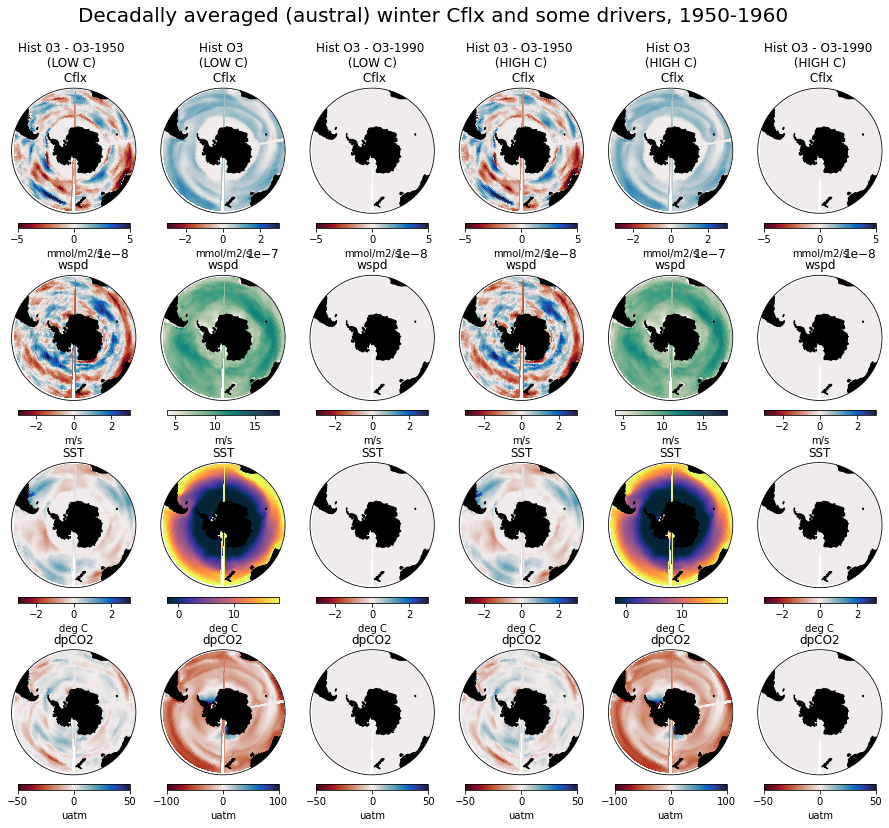

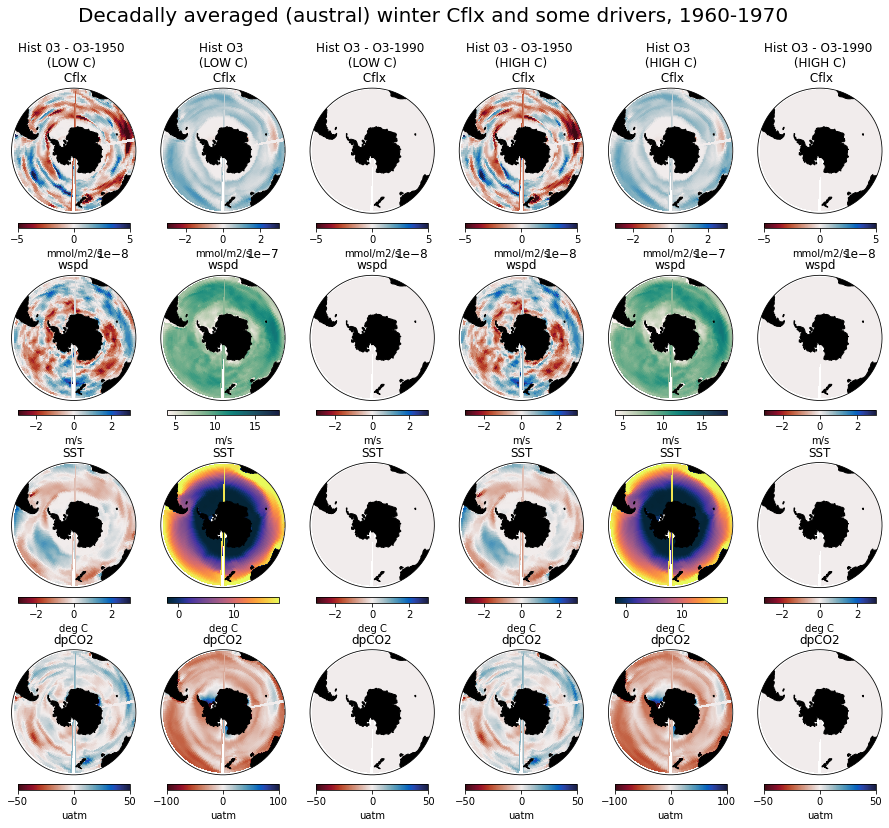

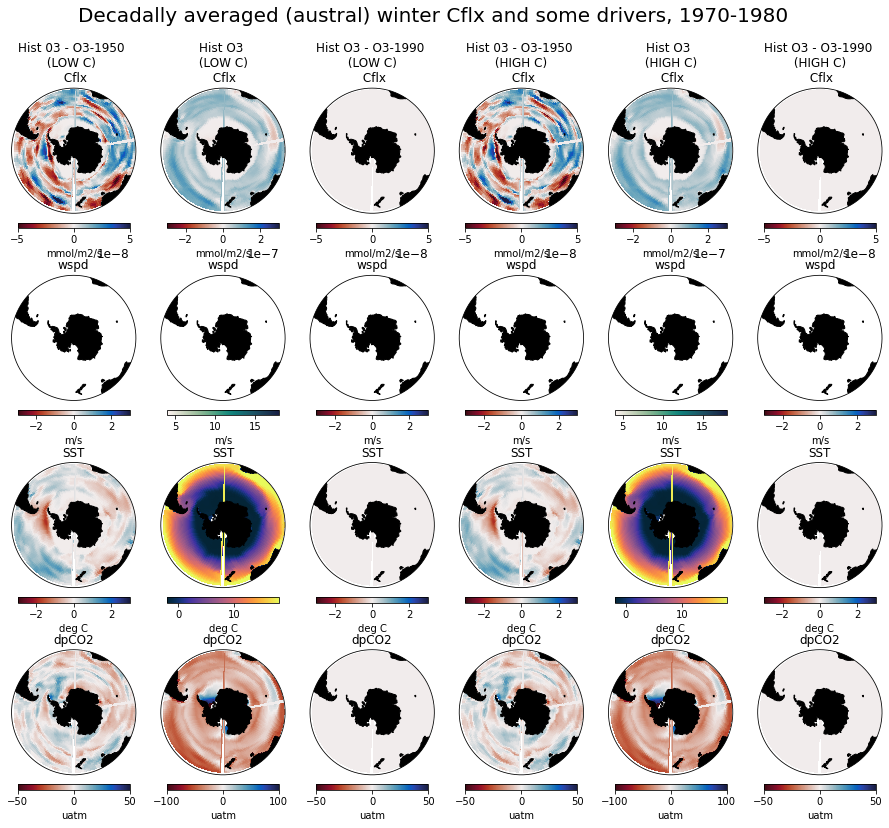

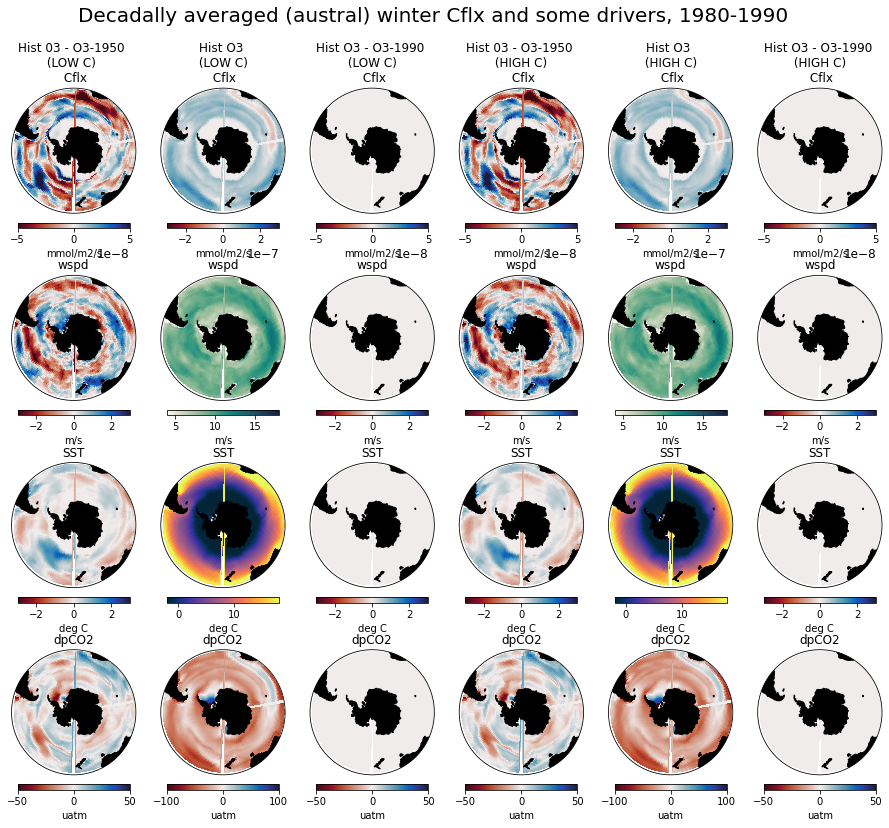

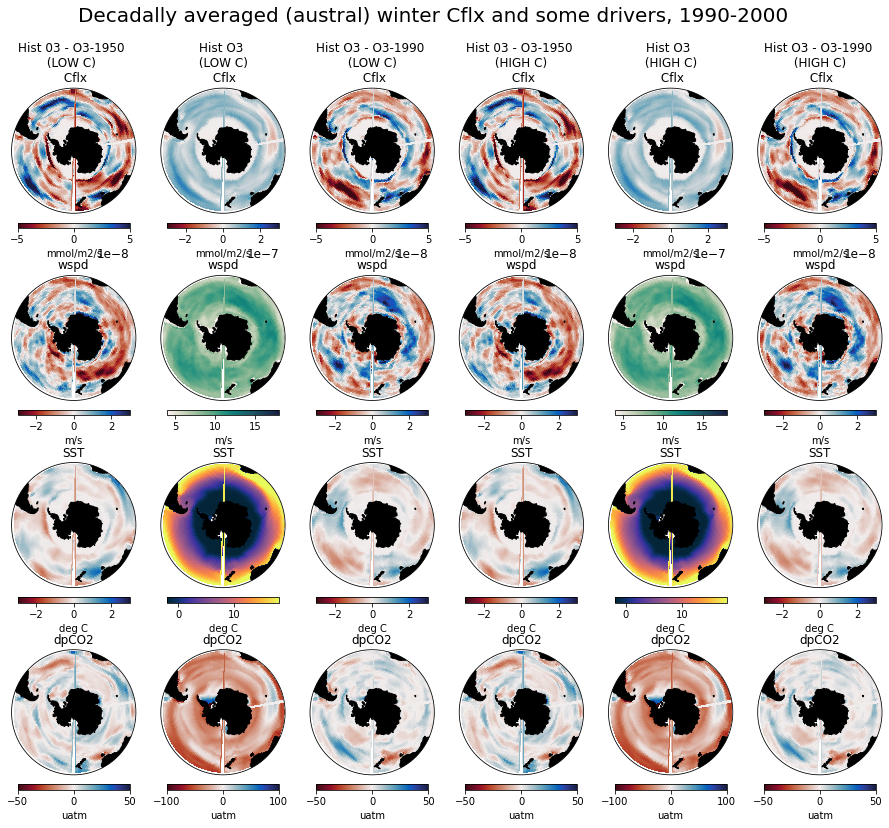

...

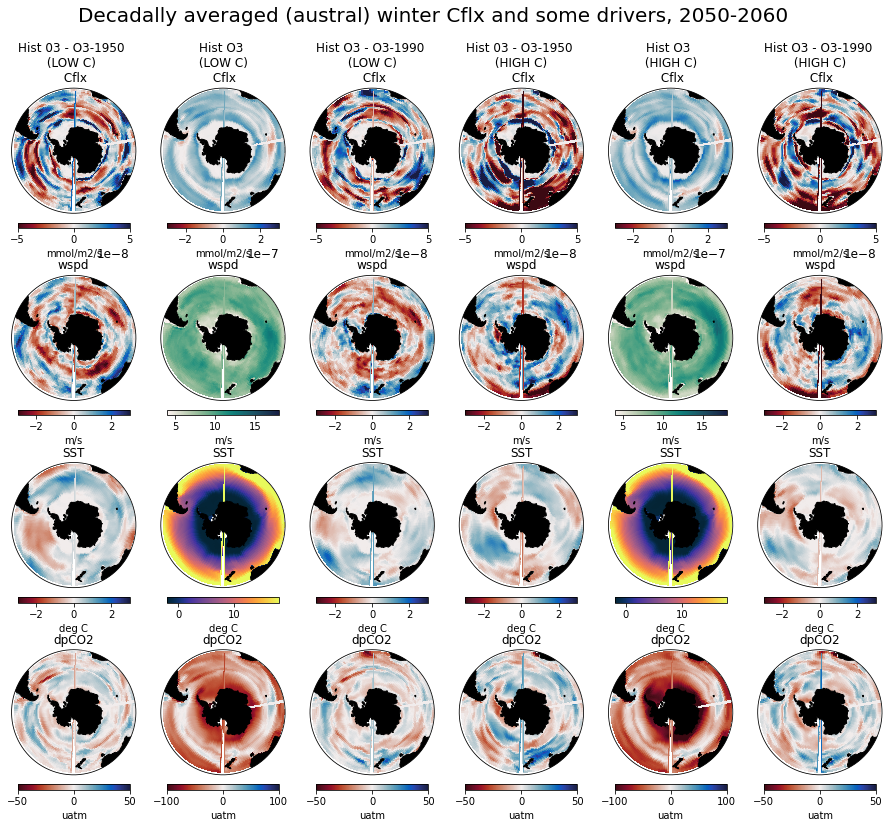

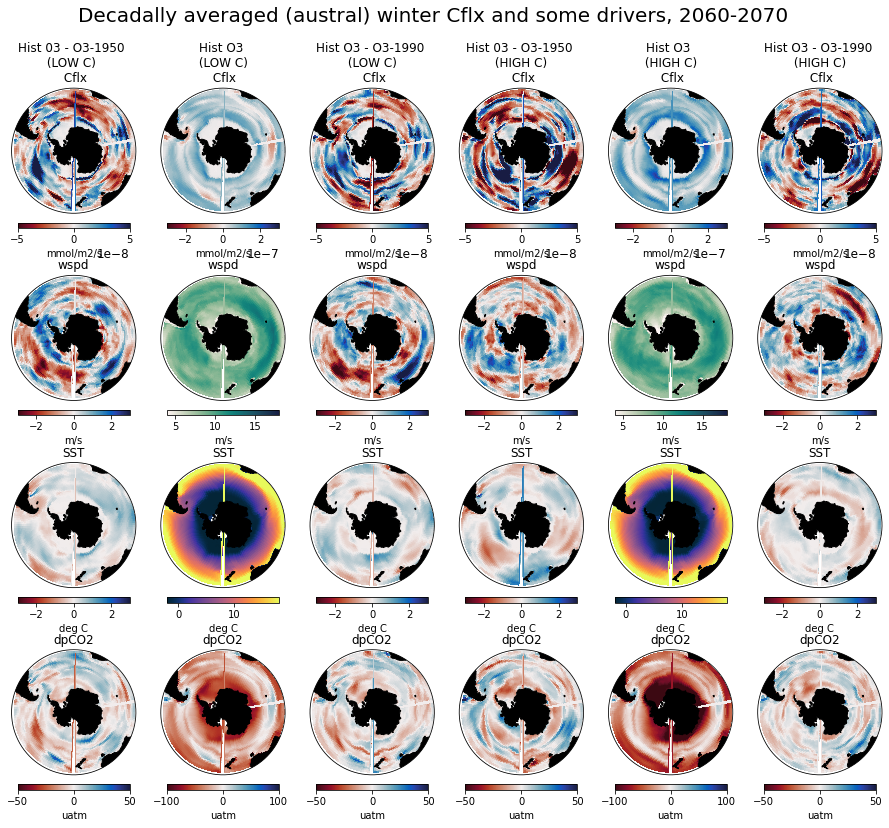

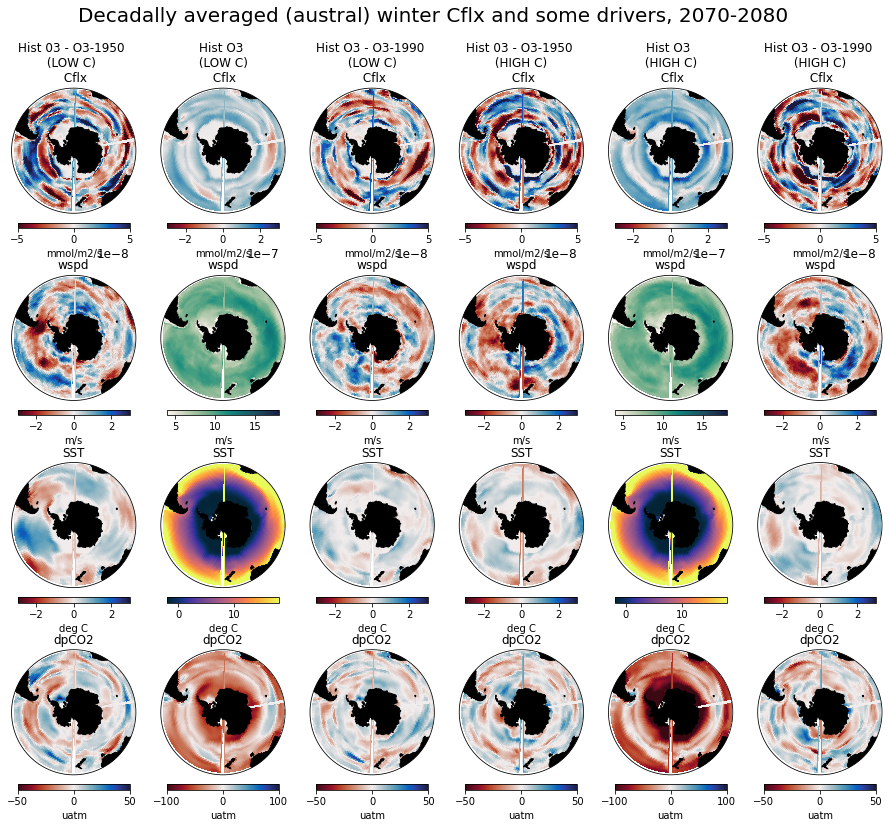

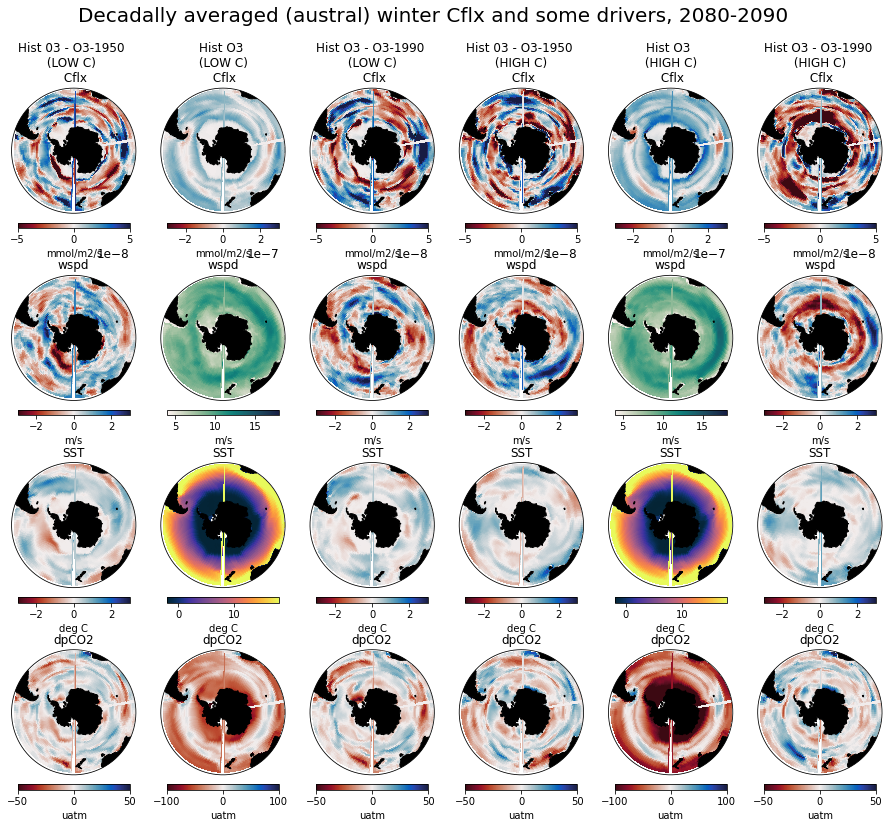

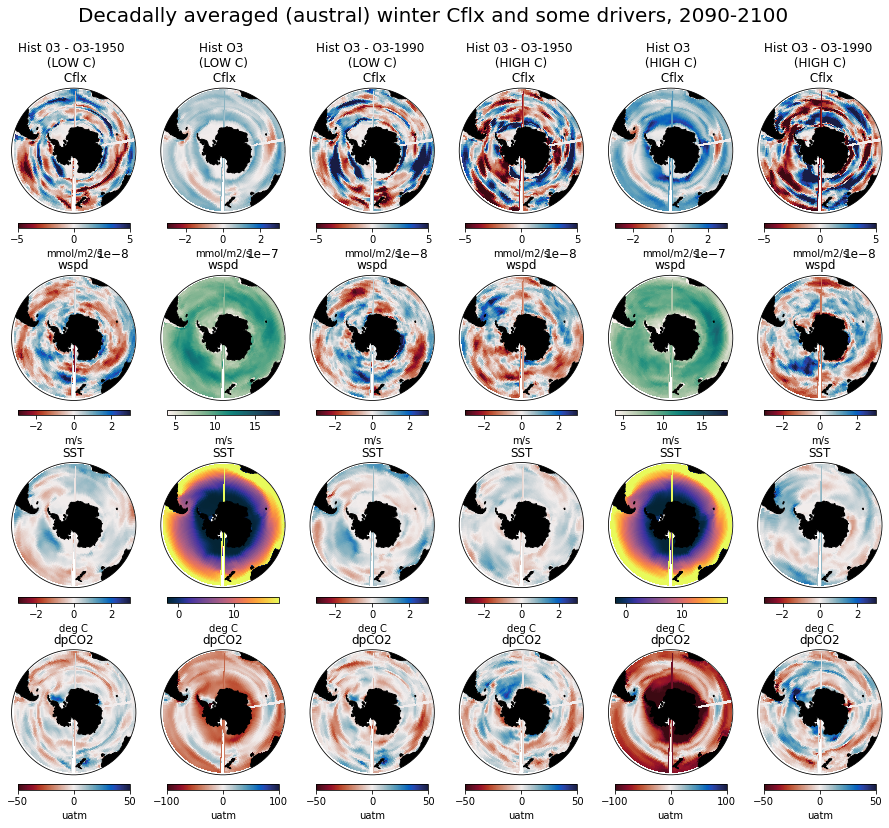

In [69]:

for ty in range(1950,2100,10):
    print(ty)
    fact = 0.3
    tfig = plt.figure(figsize=[52*fact, 44*fact])
    runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']

    te = ty+10

    tmi = [-5e-8,-3e-7,-5e-8,-5e-8,-3e-7,-5e-8]
    tma = [5e-8,3e-7,5e-8,5e-8,3e-7,5e-8]
    runs = [dec_avg(ty,'1ASA','Cflx')-dec_avg(ty,'2ASA','Cflx'),
            dec_avg(ty,'1ASA','Cflx'),
            dec_avg(ty,'1ASA','Cflx')-dec_avg(ty,'3ASA','Cflx'),
            dec_avg(ty,'1BSA','Cflx')-dec_avg(ty,'2BSA','Cflx'),
            dec_avg(ty,'1BSA','Cflx'),
            dec_avg(ty,'1BSA','Cflx')-dec_avg(ty,'3BSA','Cflx')]
    tits = ['Hist 03 - O3-1950 \n (LOW C)  \n Cflx', 
            'Hist O3 \n (LOW C) \n Cflx', 'Hist O3 - O3-1990 \n (LOW C) \n Cflx',\
           'Hist 03 - O3-1950 \n (HIGH C) \n Cflx', 
            'Hist O3 \n (HIGH C) \n Cflx',
            'Hist O3 - O3-1990 \n (HIGH C) \n Cflx']
    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'mmol/m2/s', tcmap = cm.balance_r, lm = True, cbr = True)

    ###
    tmi = [-3,4,-3,-3,4,-3]
    tma = [3,18,3,3,18,3]
    runs = [dec_avg(ty,'1A','wspd')-dec_avg(ty,'2A','wspd'),
            dec_avg(ty,'1A','wspd'),
            dec_avg(ty,'1A','wspd')-dec_avg(ty,'3A','wspd'),
            dec_avg(ty,'1B','wspd')-dec_avg(ty,'2B','wspd'),
            dec_avg(ty,'1B','wspd'),
            dec_avg(ty,'1B','wspd')-dec_avg(ty,'3B','wspd')]
    tits = ['wspd','wspd','wspd','wspd','wspd','wspd']
    cmaps = [cm.balance_r, cm.tempo, cm.balance_r,cm.balance_r, cm.tempo, cm.balance_r]
    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+6, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'm/s', tcmap = cmaps[i-1], lm = True, cbr = True)

    ####
    runs = [dec_avg(ty,'1ASA','votemper')-dec_avg(ty,'2ASA','votemper'),
            dec_avg(ty,'1ASA','votemper'),
            dec_avg(ty,'1ASA','votemper')-dec_avg(ty,'3ASA','votemper'),
            dec_avg(ty,'1BSA','votemper')-dec_avg(ty,'2BSA','votemper'),
            dec_avg(ty,'1BSA','votemper'),
            dec_avg(ty,'1BSA','votemper')-dec_avg(ty,'3BSA','votemper')]
    tits = ['SST','SST','SST','SST','SST','SST']
    cmaps = [cm.balance_r, cm.thermal, cm.balance_r,cm.balance_r, cm.thermal, cm.balance_r]
    tmi = [-3,-2,-3,-3,-2,-3]
    tma = [3,18,3,3,18,3]

    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+12, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'deg C', tcmap = cmaps[i-1], 
                      lm = True, cbr = True)

    ####
    runs = [dec_avg(ty,'1ASA','dpCO2')-dec_avg(ty,'2ASA','dpCO2'),
            dec_avg(ty,'1ASA','dpCO2'),
            dec_avg(ty,'1ASA','dpCO2')-dec_avg(ty,'3ASA','dpCO2'),
            dec_avg(ty,'1BSA','dpCO2')-dec_avg(ty,'2BSA','dpCO2'),
            dec_avg(ty,'1BSA','dpCO2'),
            dec_avg(ty,'1BSA','dpCO2')-dec_avg(ty,'3BSA','dpCO2')]
    tits = ['dpCO2','dpCO2','dpCO2','dpCO2','dpCO2','dpCO2']
    cmaps = [cm.balance_r, cm.thermal, cm.balance_r,cm.balance_r, cm.thermal, cm.balance_r]
    tmi = [-50,-100,-50,-50,-100,-50]
    tma = [50,100,50,50,100,50]

    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+18, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'uatm', tcmap = cm.balance_r, 
                      lm = True, cbr = True)

    plt.suptitle(f'Decadally averaged (austral) winter Cflx and some drivers, {ty}-{te}', 
                 fontsize = 20, y = 0.95)
    tfig.tight_layout()
    tfig.savefig(f'./PIC/decad/DECADAL_winter_{ty}.jpg', dpi = 100)


1950
1960
1970
1980
1990
2000
2010
2020
2030
2040
2050
2060
2070
2080
2090


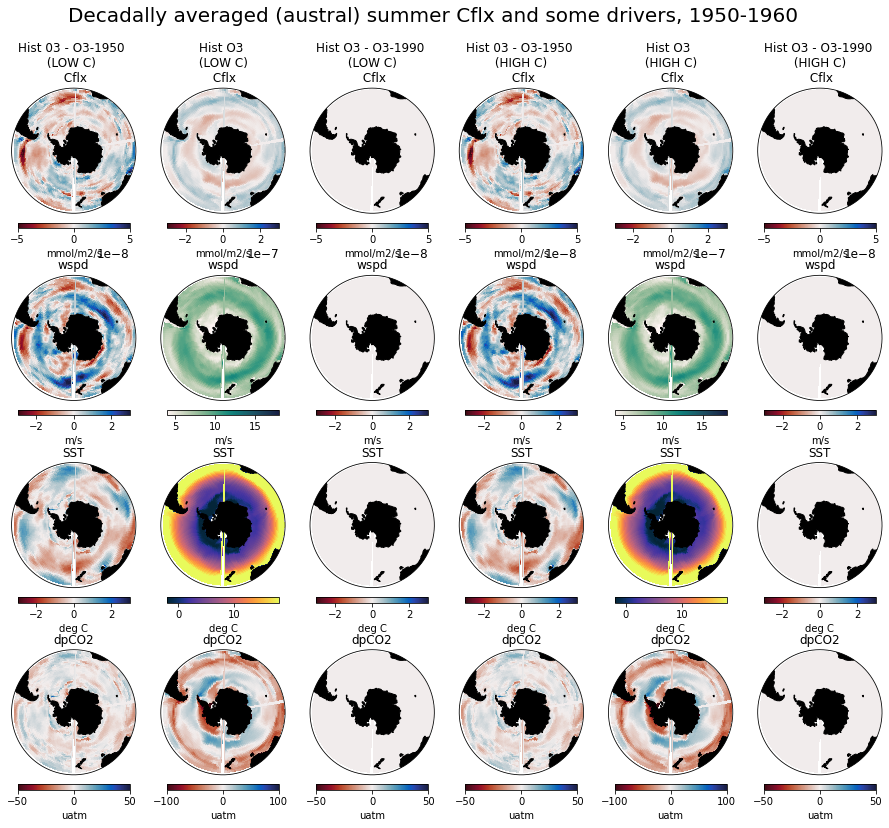

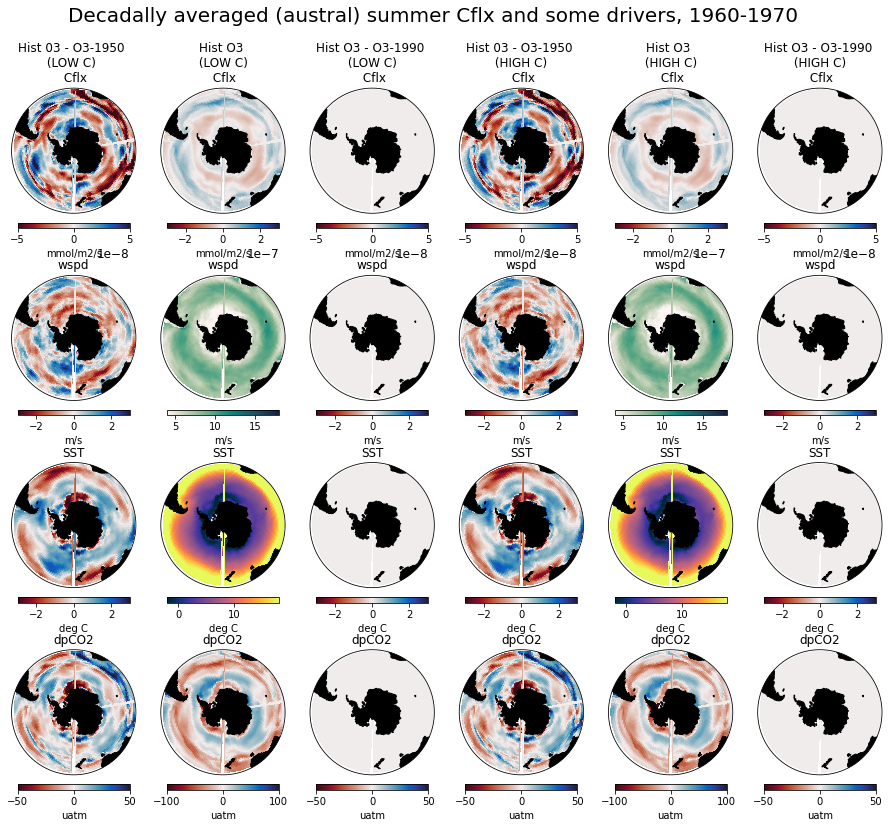

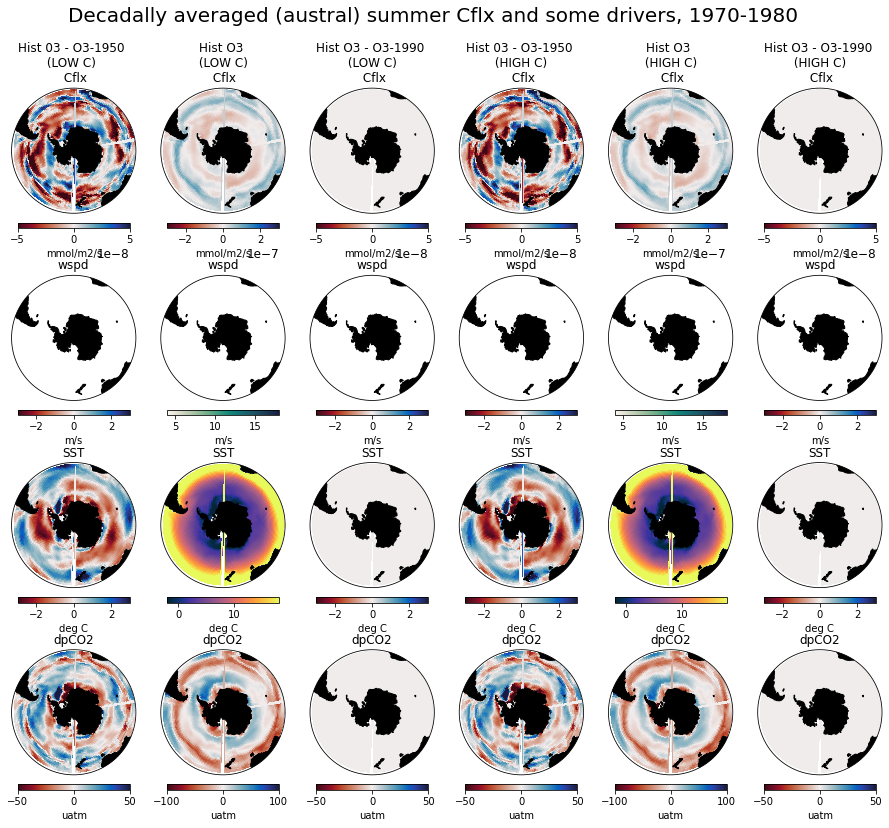

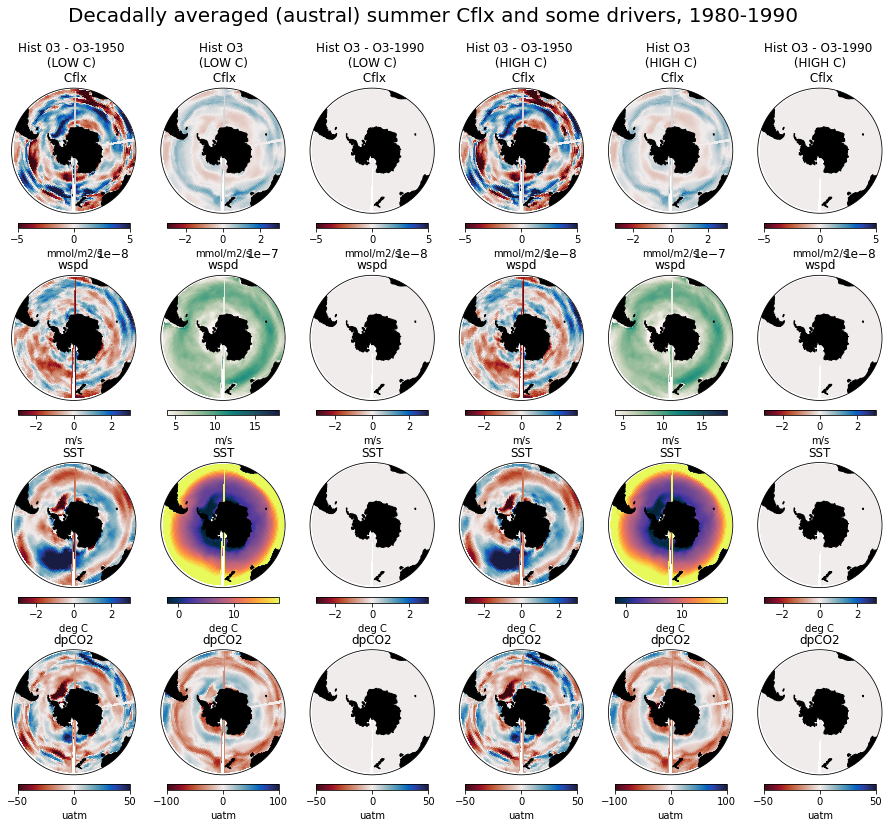

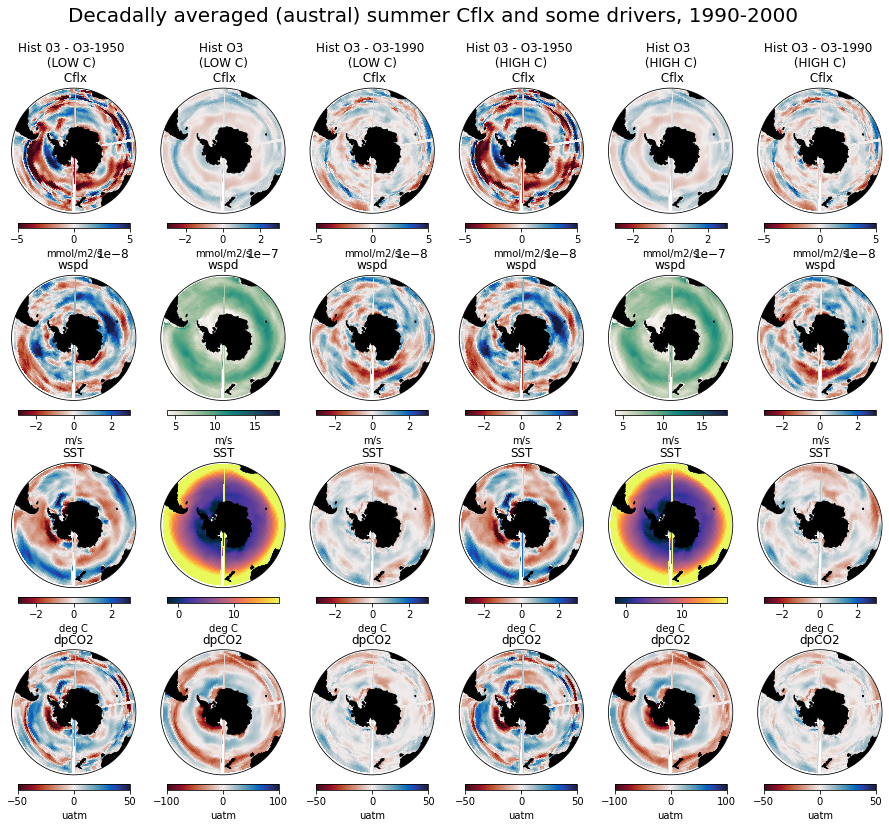

...

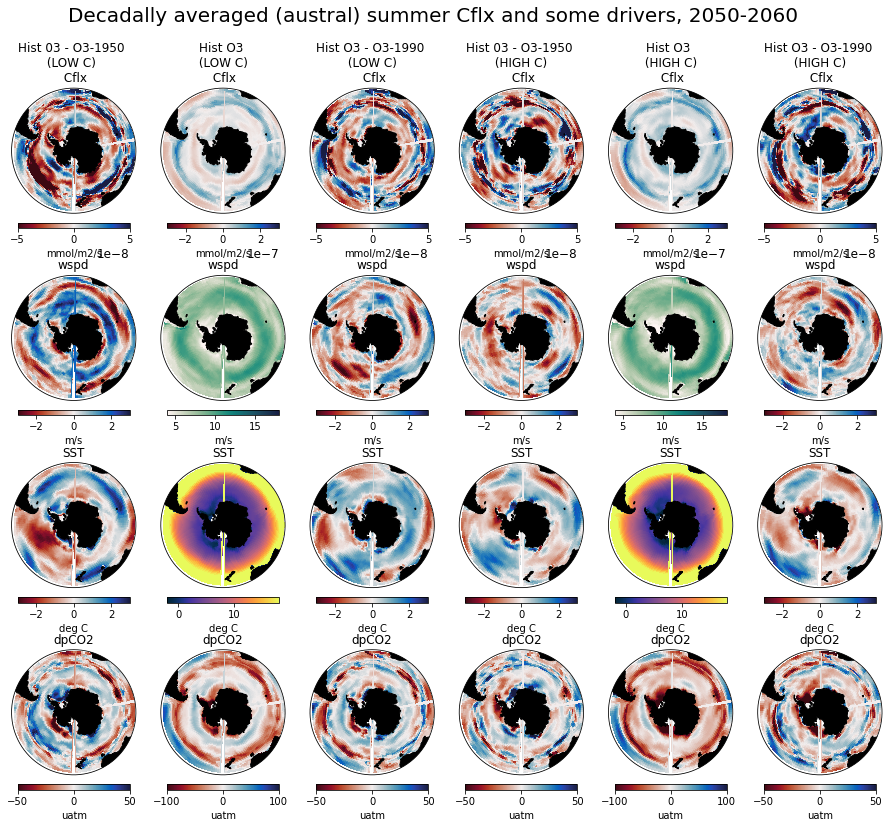

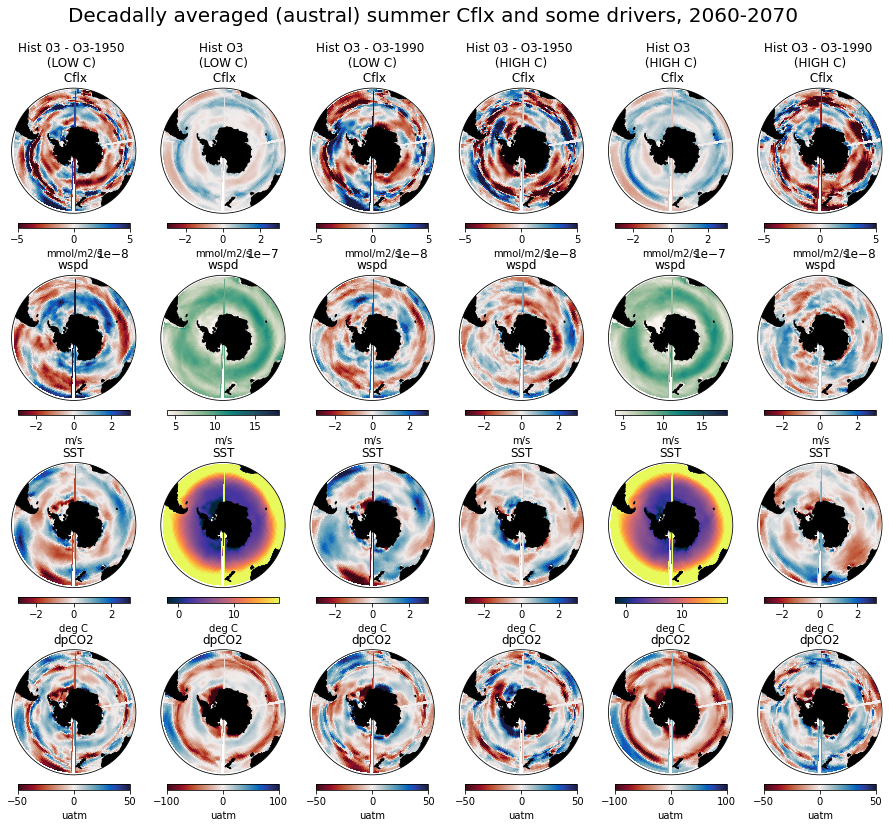

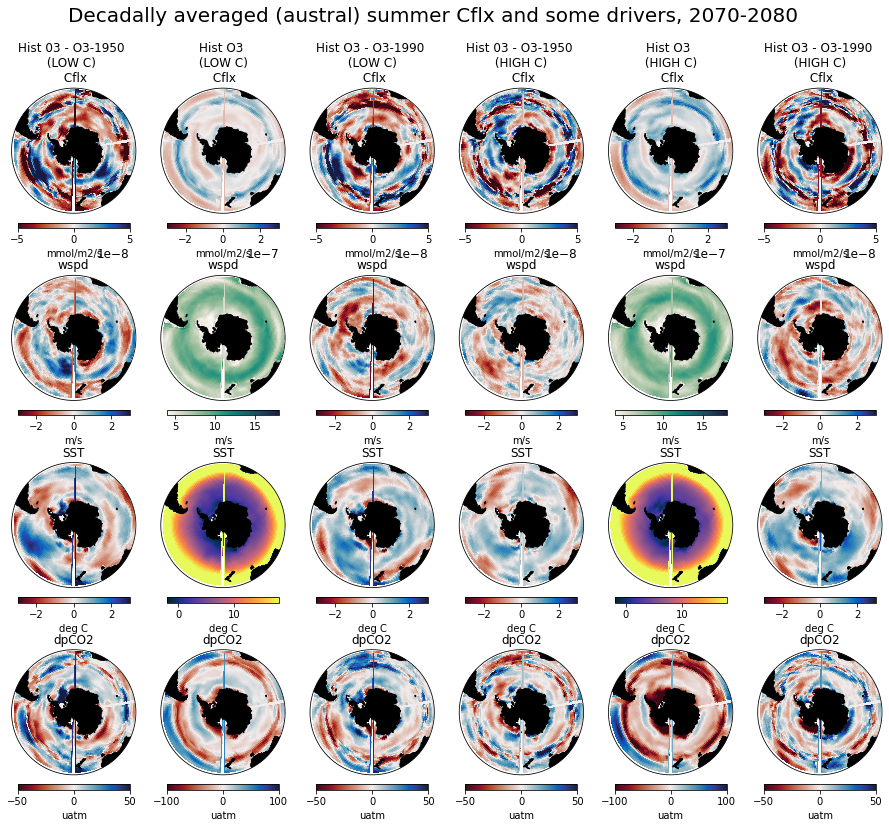

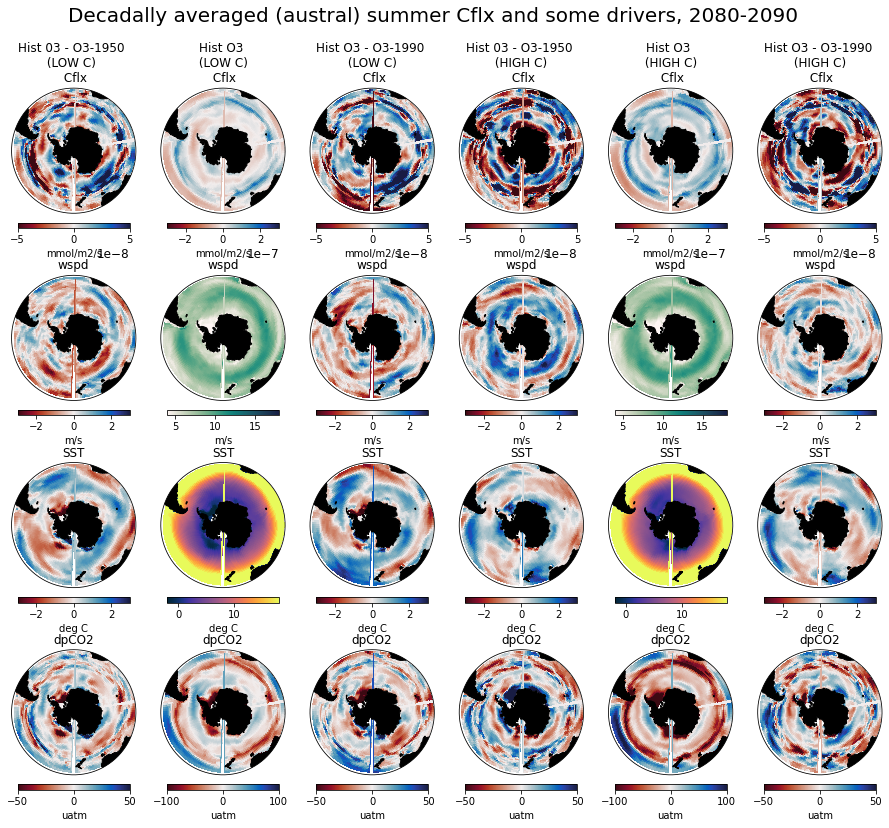

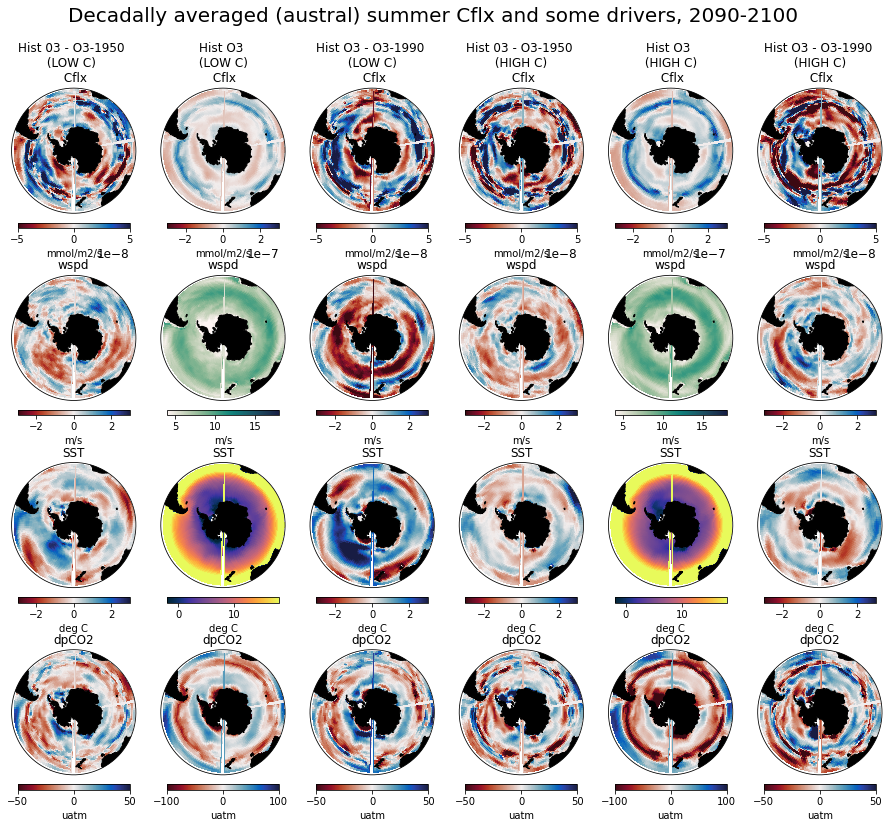

In [70]:

for ty in range(1950,2100,10):
    print(ty)
    fact = 0.3
    tfig = plt.figure(figsize=[52*fact, 44*fact])
    runs = ['2ASA', '1ASA','3ASA', '2BSA', '1BSA', '3BSA']

    te = ty+10

    tmi = [-5e-8,-3e-7,-5e-8,-5e-8,-3e-7,-5e-8]
    tma = [5e-8,3e-7,5e-8,5e-8,3e-7,5e-8]
    runs = [dec_avg(ty,'1ASA','Cflx', seas = 'summer')-dec_avg(ty,'2ASA','Cflx', seas = 'summer'),
            dec_avg(ty,'1ASA','Cflx', seas = 'summer'),
            dec_avg(ty,'1ASA','Cflx', seas = 'summer')-dec_avg(ty,'3ASA','Cflx', seas = 'summer'),
            dec_avg(ty,'1BSA','Cflx', seas = 'summer')-dec_avg(ty,'2BSA','Cflx', seas = 'summer'),
            dec_avg(ty,'1BSA','Cflx', seas = 'summer'),
            dec_avg(ty,'1BSA','Cflx', seas = 'summer')-dec_avg(ty,'3BSA','Cflx', seas = 'summer')]
    tits = ['Hist 03 - O3-1950 \n (LOW C)  \n Cflx', 
            'Hist O3 \n (LOW C) \n Cflx', 'Hist O3 - O3-1990 \n (LOW C) \n Cflx',\
           'Hist 03 - O3-1950 \n (HIGH C) \n Cflx', 
            'Hist O3 \n (HIGH C) \n Cflx',
            'Hist O3 - O3-1990 \n (HIGH C) \n Cflx']
    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'mmol/m2/s', tcmap = cm.balance_r, lm = True, cbr = True)

    ###
    tmi = [-3,4,-3,-3,4,-3]
    tma = [3,18,3,3,18,3]
    runs = [dec_avg(ty,'1A','wspd', seas = 'summer')-dec_avg(ty,'2A','wspd', seas = 'summer'),
            dec_avg(ty,'1A','wspd', seas = 'summer'),
            dec_avg(ty,'1A','wspd', seas = 'summer')-dec_avg(ty,'3A','wspd', seas = 'summer'),
            dec_avg(ty,'1B','wspd', seas = 'summer')-dec_avg(ty,'2B','wspd', seas = 'summer'),
            dec_avg(ty,'1B','wspd', seas = 'summer'),
            dec_avg(ty,'1B','wspd', seas = 'summer')-dec_avg(ty,'3B','wspd', seas = 'summer')]
    tits = ['wspd','wspd','wspd','wspd','wspd','wspd']
    cmaps = [cm.balance_r, cm.tempo, cm.balance_r,cm.balance_r, cm.tempo, cm.balance_r]
    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+6, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'm/s', tcmap = cmaps[i-1], lm = True, cbr = True)

    ####
    runs = [dec_avg(ty,'1ASA','votemper', seas = 'summer')-dec_avg(ty,'2ASA','votemper', seas = 'summer'),
            dec_avg(ty,'1ASA','votemper', seas = 'summer'),
            dec_avg(ty,'1ASA','votemper', seas = 'summer')-dec_avg(ty,'3ASA','votemper', seas = 'summer'),
            dec_avg(ty,'1BSA','votemper', seas = 'summer')-dec_avg(ty,'2BSA','votemper', seas = 'summer'),
            dec_avg(ty,'1BSA','votemper', seas = 'summer'),
            dec_avg(ty,'1BSA','votemper', seas = 'summer')-dec_avg(ty,'3BSA','votemper', seas = 'summer')]
    tits = ['SST','SST','SST','SST','SST','SST']
    cmaps = [cm.balance_r, cm.thermal, cm.balance_r,cm.balance_r, cm.thermal, cm.balance_r]
    tmi = [-3,-2,-3,-3,-2,-3]
    tma = [3,18,3,3,18,3]

    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+12, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'deg C', tcmap = cmaps[i-1], 
                      lm = True, cbr = True)

    ####
    runs = [dec_avg(ty,'1ASA','dpCO2', seas = 'summer')-dec_avg(ty,'2ASA','dpCO2', seas = 'summer'),
            dec_avg(ty,'1ASA','dpCO2', seas = 'summer'),
            dec_avg(ty,'1ASA','dpCO2', seas = 'summer')-dec_avg(ty,'3ASA','dpCO2', seas = 'summer'),
            dec_avg(ty,'1BSA','dpCO2', seas = 'summer')-dec_avg(ty,'2BSA','dpCO2', seas = 'summer'),
            dec_avg(ty,'1BSA','dpCO2', seas = 'summer'),
            dec_avg(ty,'1BSA','dpCO2', seas = 'summer')-dec_avg(ty,'3BSA','dpCO2', seas = 'summer')]
    tits = ['dpCO2','dpCO2','dpCO2','dpCO2','dpCO2','dpCO2']
    cmaps = [cm.balance_r, cm.thermal, cm.balance_r,cm.balance_r, cm.thermal, cm.balance_r]
    tmi = [-50,-100,-50,-50,-100,-50]
    tma = [50,100,50,50,100,50]

    for i in range(1,7):
        ax1 = tfig.add_subplot(4, 6, i+18, projection=ccrs.Orthographic(0, -90))
        tvmin = tmi[i-1]; tvmax = tma[i-1]; tticks = tti
        plot_southern(tfig, ax1, lons, lats, runs[i-1][0:50,:], tvmin, 
                      tvmax, northex = -50, fs = 12, 
                      tit = tits[i-1], cbarlab = 'uatm', tcmap = cm.balance_r, 
                      lm = True, cbr = True)

    plt.suptitle(f'Decadally averaged (austral) summer Cflx and some drivers, {ty}-{te}', 
                 fontsize = 20, y = 0.95)
    tfig.tight_layout()
    tfig.savefig(f'./PIC/decad/DECADAL_summer_{ty}.jpg', dpi = 100)
